# Turning bad gel electrophoresis images into the professionally-looking results (with Python)

An image for a publication better be looking nice. But what if your gel electrophoresis setup looks like that?

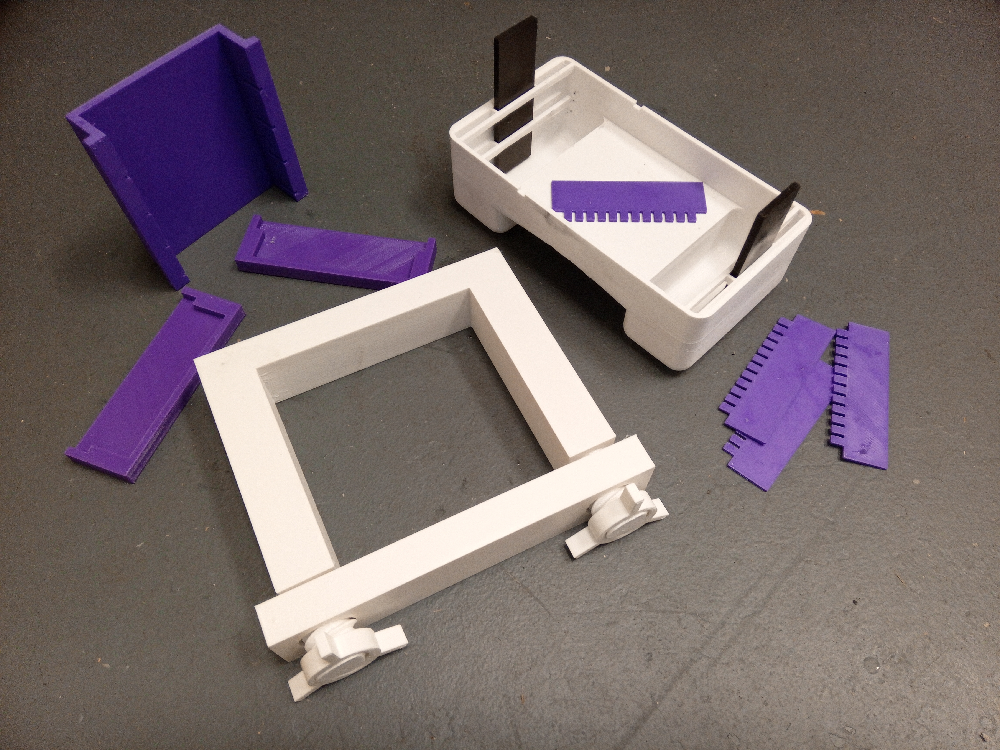

In [7]:
from IPython.display import Image
Image(filename=r'.\data\2022-03-15 19.32.53.jpg') 

And it produses images similar to this:

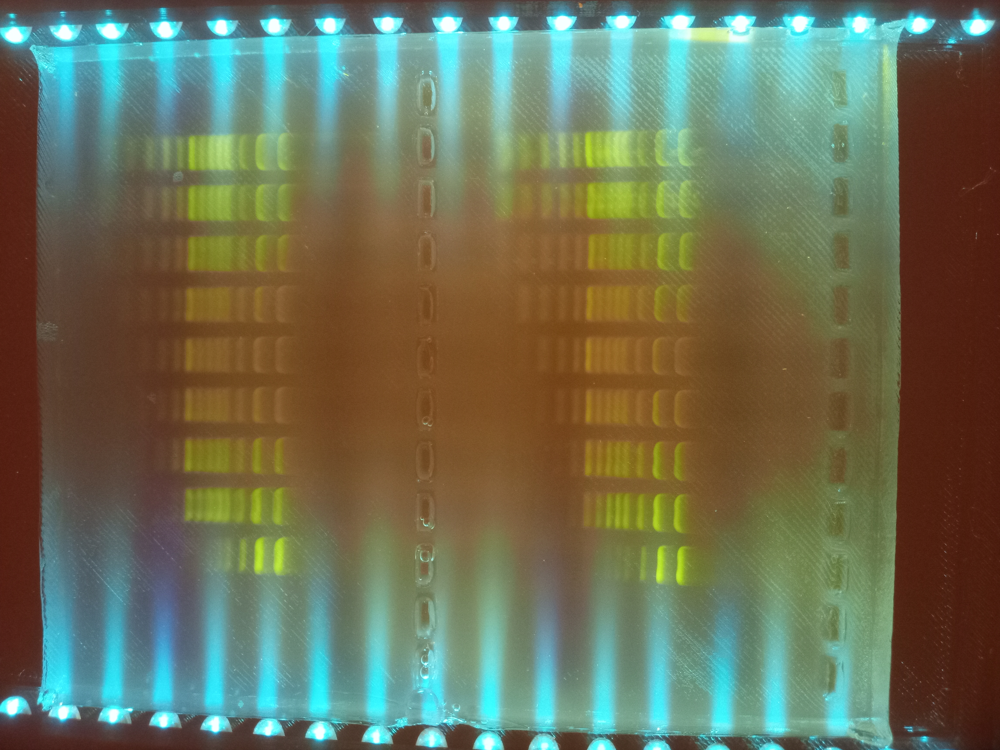

In [8]:
Image(filename=r'.\data\2022-03-10 02.36.53.jpg') 

Why does it look this way? Maybe your lab us very underfunded, or maybe you were lazy to remake the image, or you were in a hurry, or you outright refuse to pay thousands of dollars for the setup, that must cost 200 dollars at best (because super-complex smartphone cost only \$800). Or maybe you despise manual wet lab work, but don't mind tinkering with some programming, like I do.

Regardless of the reasons, I made this tutorial so you can make a professional-looking image from a very bad quality gel picture.

I am assuming that you have some experience with experimental molecular biology, as well as basic Python skills. The work is done in Jupyter notebook environment.

# Opening gel image in Jupyter notebook

In [116]:
import skimage
import scipy
from scipy.ndimage.interpolation import shift
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import cv2

To open an image, we will use OpenCV python library. Please check the separate guide for installation and basic usage.
https://pypi.org/project/opencv-python/#description
The OpenCV package will help with opening the file as well as with some basic manipulations. We well use matplotlib package to display the images. We will store images as a Numpy arrays, so you should also import numpy module.

In [16]:
import cv2
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [17]:
# This tutorial uses the following versions of the packages
print (cv2.__version__)
print (matplotlib.__version__)
print (np.__version__)

4.5.5
3.2.1
1.21.5


By default, matplotlib shows very small figures. This line will make it larger.

In [20]:
plt.rcParams['figure.figsize'] = [20, 10]

Now we will open the gel image:

In [24]:
gel = cv2.imread(r'.\data\2022-03-10 02.36.53.jpg')

The gel is the 3-dimensional numpy array, 1st and 2nd dimension represent the coordinate of a pixel, the third dimension is the color. The value at each coordinate shows the strength of each color for each point, thus forming a final picture.

In [27]:
gel.shape

(3456, 4608, 3)

Now showing only one color:

In [31]:
gel[:,:,0]

array([[82, 80, 86, ..., 68, 60, 64],
       [80, 75, 77, ..., 69, 65, 75],
       [79, 75, 73, ..., 71, 71, 67],
       ...,
       [68, 63, 64, ..., 51, 49, 46],
       [68, 63, 64, ..., 45, 48, 53],
       [63, 62, 63, ..., 44, 43, 39]], dtype=uint8)

The first line opens the gel. However, the colors will be distorted, because OpenCV and Matplotlib interpret colors differently. To fix that, we need to swap the color dimensions, so the Matplotlib now outputs correct colors

In [ ]:
gel = gel[...,::-1]

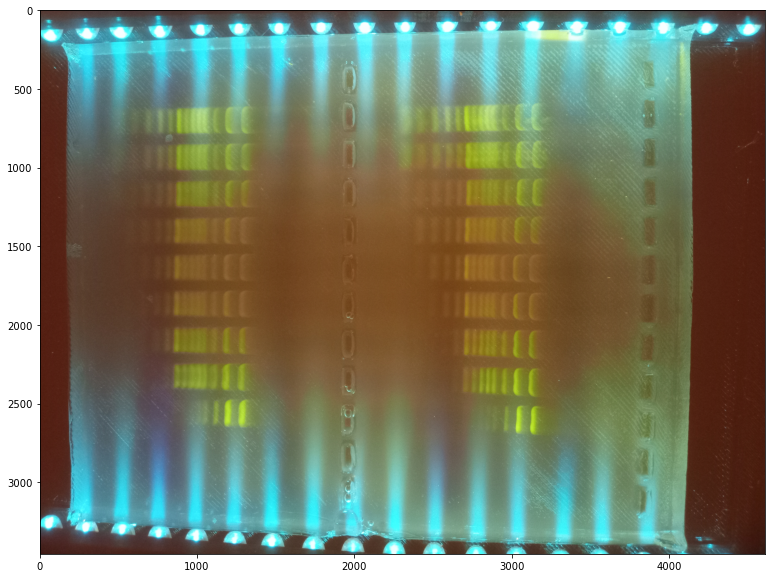

In [32]:
plt.imshow(gel)

Now the picture is opened and ready for the further manipulations

## Rotating the picture

Obviously, you noted that the image is sideways, and it is very hard to interpret. Fortunately, it is very easy to rotate the image using OpenCV:

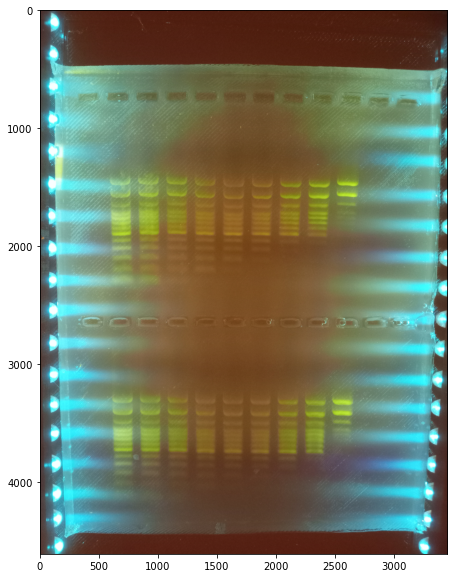

In [37]:
plt.imshow(cv2.rotate(gel, cv2.ROTATE_90_COUNTERCLOCKWISE))

# Straightening the gel

The gel supposed to be square shape, but our picture taking setup was far from ideal (I took a picture on the cell phone while holding a UW light filter with my other hand). As a result, the cell phone plane was not parallel with the gel plane, and gel comes out distorted.

At this step, we will fix this distortion.

To simplify the task, we transform the gel into grayscale.

## Transforming image to grayscale

In [34]:
gray = cv2.cvtColor(gel, cv2.COLOR_BGR2GRAY)

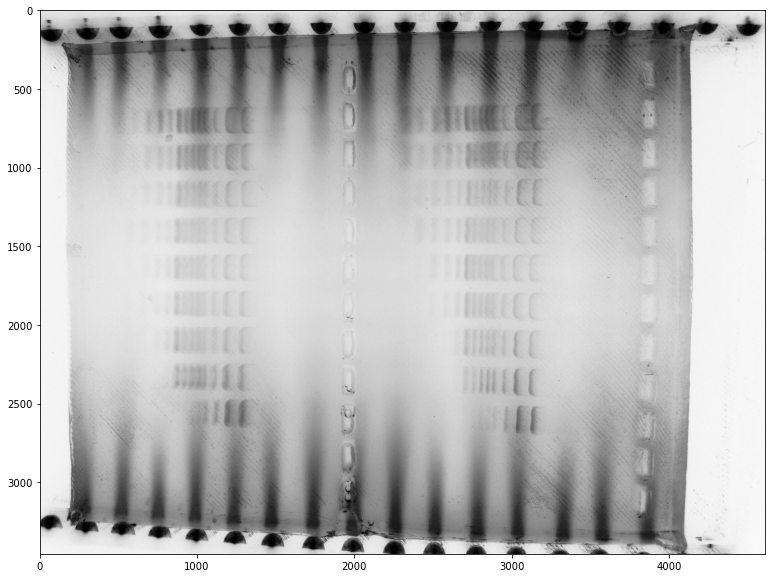

In [39]:
plt.imshow(gray, cmap='Greys')

I prefer the Matplotlib standard palette for displaying monochrome images, so here:

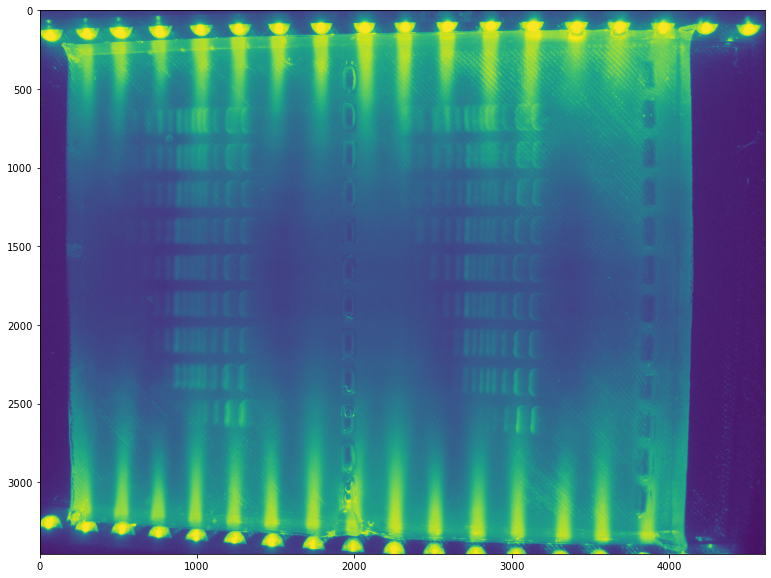

In [40]:
plt.imshow(gray)

I kept the image tilted for simplicity; we will make it vertical at the future steps

The resulting array is two-dimensional:

In [41]:
gray.shape

(3456, 4608)

## Manually finding the gel corners coordinates

To find the coordinates, we will set arbitrary (x, y) coordinates of each corner. Using thouse coordinates, we will make a mask that will cover everything outside the desired area. We will plot the masked picture. The coverage will likely be not ideal, so we will correct the coordinates and replot. We will continue until we are satisfied with the result.

In [49]:
upper_left = (160, 200)
upper_right = (4150, 100)
lower_right = (4110, 3420)
lower_left = (190, 3260)

corners_coordinates = np.array([[upper_left, upper_right, lower_right, lower_left]], dtype=np.int32)

In [50]:
mask = np.zeros(gray.shape, dtype="uint8")
mask = cv2.fillPoly(mask, corners_coordinates, 255)
masked = cv2.bitwise_and(gray, mask)

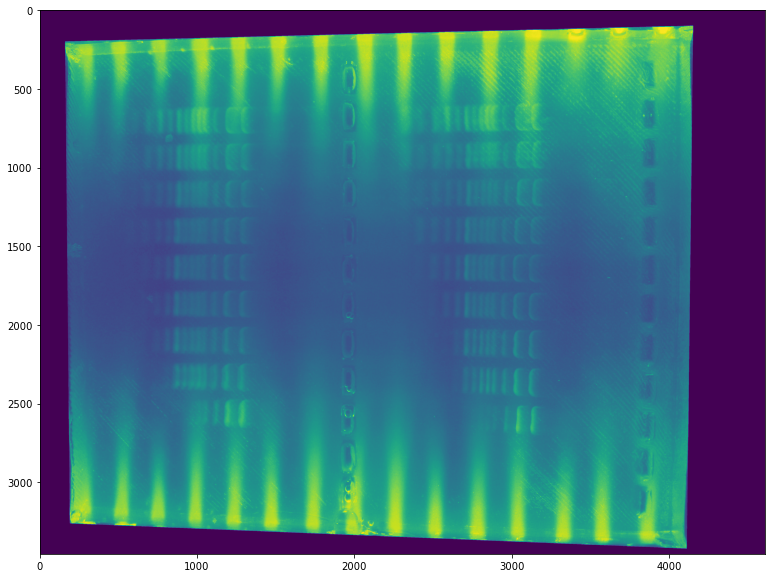

In [52]:
plt.imshow(masked)

## Stretching the gel image into top-down view

The transformation uses the OpenCV funtions "getPerspectiveTransform" and "warpPerspective". Collectively, they take the original image with known corner coordinates and "stretch" (or shrink) it to the new corner coordinates. To use those functions, we need to provide it with the original image, the original corner coordinates,
and with the desired new corner coordinates.

Lets organize those technical manipulations into the function:

In [174]:
def fourPointTransform(image, top_left, top_right, bottom_right, bottom_left):
    # transforming point coordinates into array
    rect = np.array([top_left, top_right, bottom_right, bottom_left], dtype=np.float32)
    (tl, tr, br, bl) = rect

    # compute the width and height of the new image, which will be the
    # maximum distance between bottom-right and bottom-left
    # x-coordiates or the top-right and top-left x-coordinates
    # Same for the y-coordinates.
    calcLength = lambda a, b: np.sqrt(((a[0] - b[0]) ** 2) + ((a[1] - b[1]) ** 2))
    maxLength = lambda a, b, c, d: max(int(calcLength(a, b)), int(calcLength(c, d)))
    
    maxWidth = maxLength(br, bl, tr, tl)
    maxHeight = maxLength(tr, br, tl, bl)
    
    # Constructing the set of destination points to obtain a top-down view of the gel.
    # Points are in the top-left, top-right, bottom-right, and bottom-left
    # order
    dst = np.array([
        [0, 0],
        [maxWidth - 1, 0],
        [maxWidth - 1, maxHeight - 1],
        [0, maxHeight - 1]], dtype = "float32")

    # compute the perspective transform matrix and then apply it
    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(image, M, (maxWidth, maxHeight))
    warped = warped.astype(np.int16)
    
    # return the warped image
    return warped

In [175]:
transformed = fourPointTransform(gray, upper_left, upper_right, lower_right, lower_left)

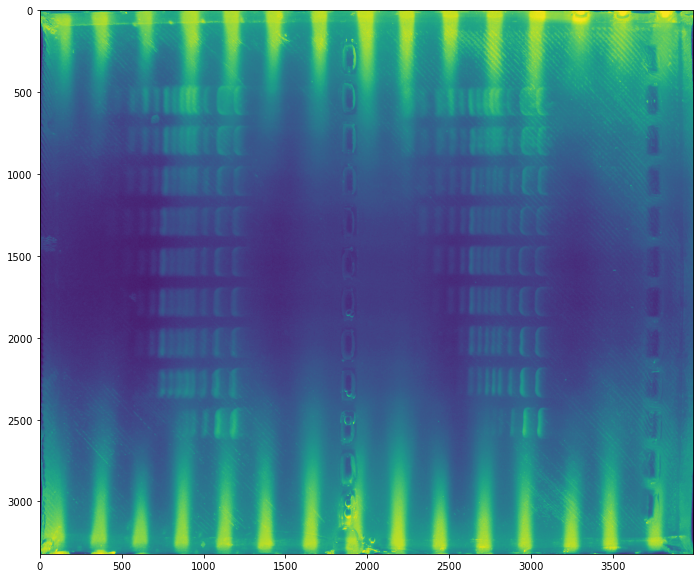

In [176]:
plt.imshow(transformed)

# Removing the background

The resulting square-shaped monochrome gel image still has a lot of artifacts. 

First, most notable, is the high-intensity (yellow) stripes on the sides. I used standard blue LEDs to illuminate the gel in my hand-made transilluminator. It costed me almost nothing to build it, but now the LEDs beam strong light strobes into the gel. That light causes the gel to fluoresce even without the DNA present, resulting in a strong beams where the light intensity is the highest.

The second is even without the bright stripes, the gel background is not uniform. It is brighter on the side and darker in the center. 

One way to deal with those is to create a very blurred image of the gel and subtract it from the original. The blurred image will average out the small features, such as DNA bands, but preserve the bigger features, such as the background gradients.

OpenCV can perform the operation called "GaussianBlur", that requires the original image and the size of the area at which to perform the Gaussian blurring. The area does not have to be circle; rather, in this case, it is better to use the elliptic one. This way, we can capture finer features, such as the light stripes on the side.

The size of the averaged area (209, 2009) is found by the trial and error, it is better to adjust this value for every case separately.

In [178]:
bkgnd = cv2.GaussianBlur(transformed, (209, 2009), 0)

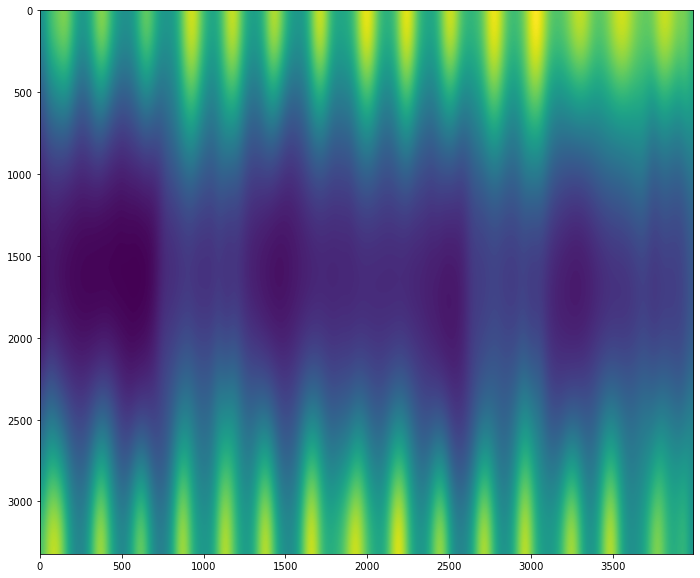

In [179]:
plt.imshow(bkgnd)

The resulting background picture looks pretty much the same except the DNA bands are not present. This is what we wanted.

Now subtracting the background from the original and plotting the results

In [180]:
subtr1 = transformed - bkgnd

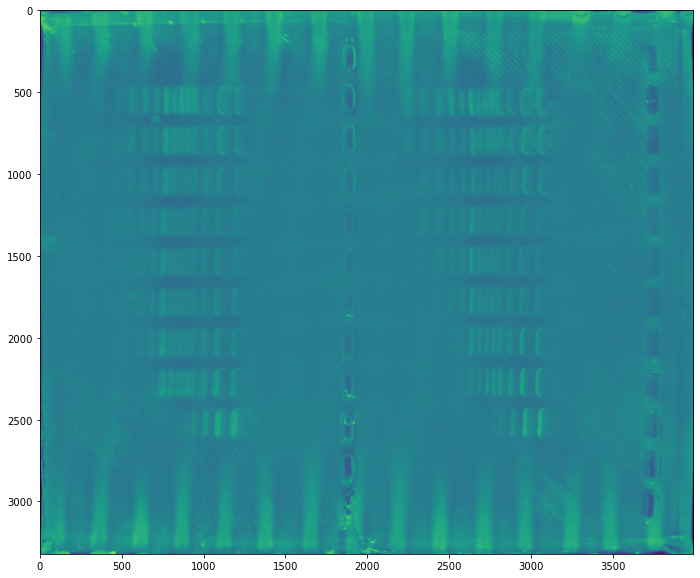

In [181]:
plt.imshow(subtr1)

As you can see, we completely removed background gradient and significantly decreased the intensity of the stripes.

# Isolating the lines

The next step is to transform each gel line into the plot of fluorescence intensity vs. distance. This is what the professional bioanalyzers output, and this data will allow us to build a simulated gel picture in any format or color that we want. 

It will also let us average and smooth the data, removing the remaining gel artifacts.

To do that, we calculate the mean value across all horizontal lines. The lines that has bands in them will naturally has higher average value, while the gaps between the gels will be dimmer in average.

## Generating gel profile

Here is the resulting plot. Y axis represents the fluorescence intensity, while X axis is the vertical position in the gel. The teeth-like features are our gel bands.

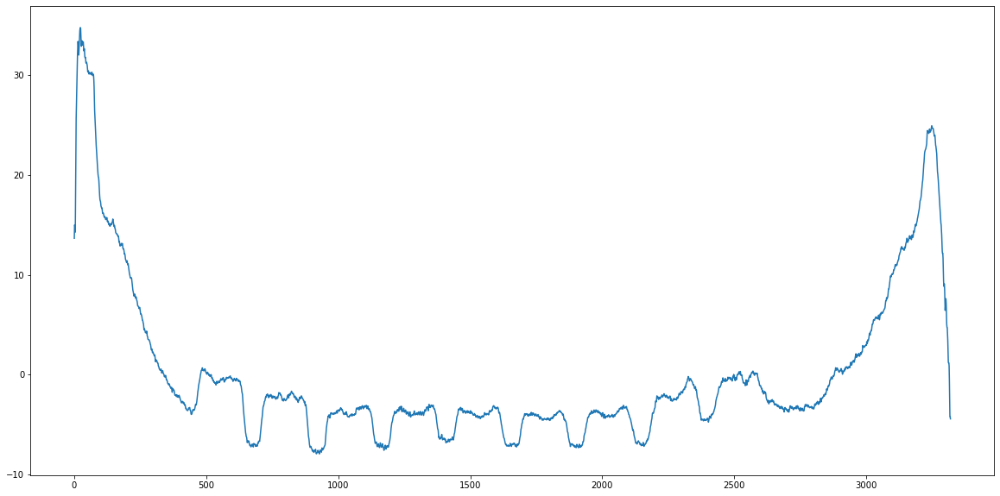

In [209]:
profile = subtr1.mean(axis=1)
plt.plot(profile)

We can also apply the noise filter to smoothen the plot. It will come handy at the next step. Scipy package has all the functionality.

In [184]:
profile_smooth = scipy.signal.savgol_filter(profile, 51, 3)

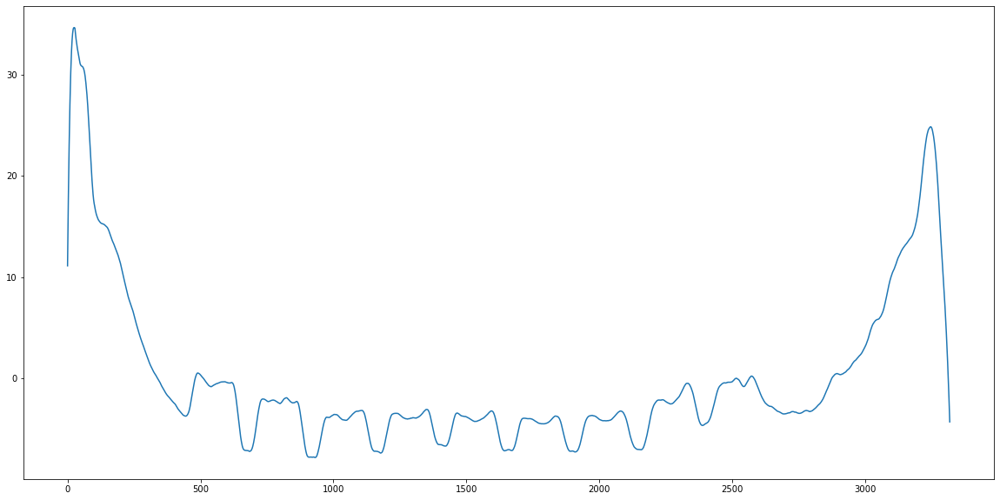

In [185]:
plt.plot(profile_smooth)

## Finding the coordinates of each gel line

We can find the approximate coordinate at which the gel starts and finish by finding the point at which the fluorescence changes the most. In the other words, we differentiate the profile of the gel:

In [212]:
differ = np.diff(profile_smooth)

We also remove the sides of the gel that does not carry any useful information for the plot

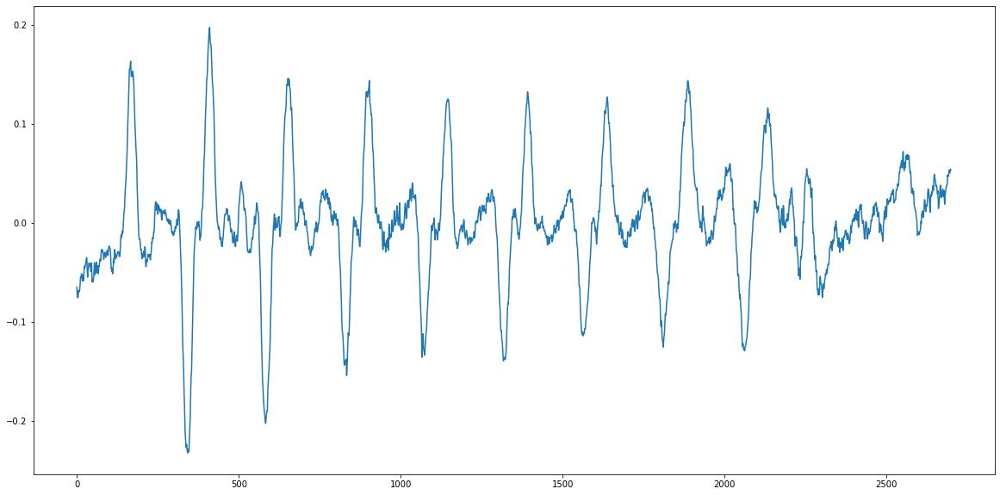

In [213]:
plt.plot(differ[300:3000])

Same as with the profile, we can apply the nois suppression:

In [214]:
differ_no_noise = scipy.signal.savgol_filter(differ, 51, 3)

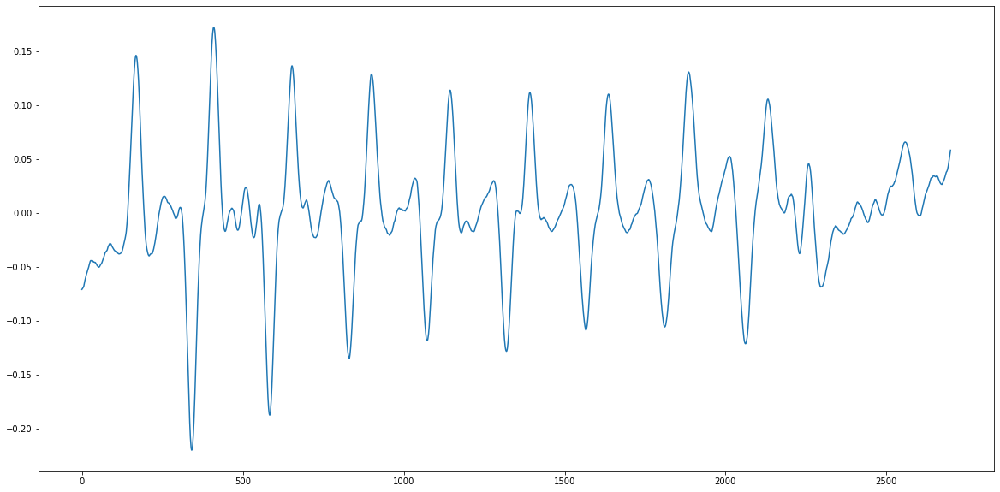

In [215]:
plt.plot(differ_no_noise[300:3000])

Cutting the theshold:

In [219]:
differ_no_noise[differ_no_noise <= 0.1] = 0

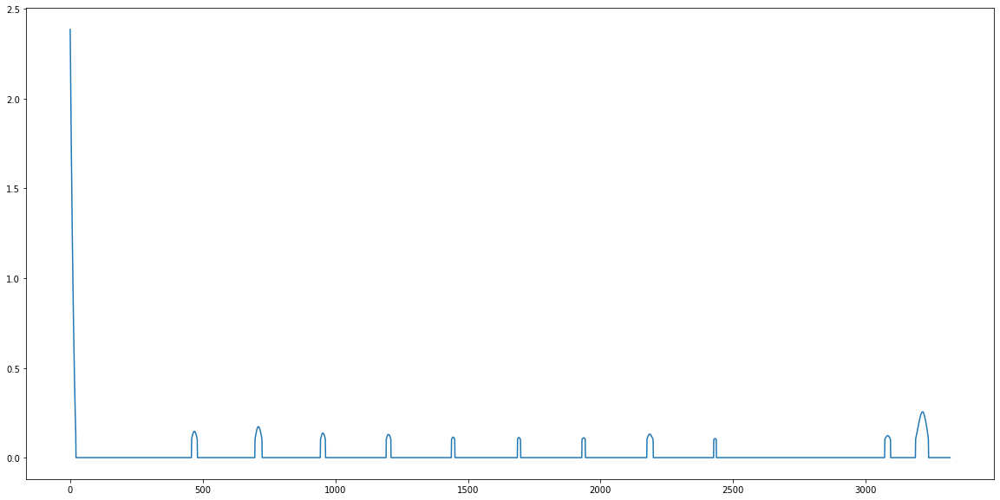

In [220]:
plt.plot(differ_no_noise)

Now attempting to find the peak coordinates automatically. 

In [230]:
peak_coords = scipy.signal.argrelextrema(differ_no_noise, np.greater)[0]
peak_coords

array([ 468,  710,  953, 1200, 1444, 1692, 1936, 2185, 2432, 3083, 3215],
      dtype=int64)

The last two peaks are the artifacts from the gel, we will ignore them.

In [231]:
peaks = peak_coords[:-2]
peaks

array([ 468,  710,  953, 1200, 1444, 1692, 1936, 2185, 2432], dtype=int64)

So here are the coodinates of where the gel lines start. We need to use slightly narrower line, to skip the irregularities at the border of each line. So, we need to add some constant to each of the peak values found before. We also need to use a certain value for the width of the gel line. We also need to agree on the length of the gel, specifying the coordinates before and after. Then, we simply slice the numpy array of the gel picture, leaving only one line. We do it with the function:

In [126]:
def extractLine(gel, fluor_increase_coord, line_width, dist_from_peak, start_point, end_point):
    line_start = fluor_increase_coord + dist_from_peak
    line_end = line_start + line_width
    line = gel[line_start:line_end, start_point:end_point]
    return line

After extracting the line, we need to average it over the width. This function will return a line that represents the fluorescence intensity versus the gel coordinate. It will still have some background, though.

In [127]:
def averageLine(line):
    return line.mean(axis=0)

We can also obtain the bacground, grabbing the empty areas around each gel line. The following function accepts two areas and calculates a mean bacground, also a line.

In [128]:
def averageBackground(bk1, bk2):
    bk1mean = averageLine(bk1)
    bk2mean = averageLine(bk2)
    bk = (bk1mean + bk2mean)/2.0
    return bk

The next function simply subtracts the background from the line

In [129]:
def bkgroundSubtract(line, background):
    return line -  background

Smoothing the line:

In [130]:
def smoothLine(line, a=51, b=5):
    return scipy.signal.savgol_filter(line, a, b)

This one calculates the average width of a line. The result is used as an input of the extractLine function we reviewed before

In [ ]:
def calcAverageBandWidth(peaks):
    diff_array = np.diff(peaks)
    return int(diff_array.mean())

Adding one extra "peak" which will serve for the background subtraction.

In [132]:
peaks.append(peaks[-1] + calcAverageBandWidth(peaks))

In [133]:
peaks

[466, 710, 952, 1196, 1446, 1692, 1938, 2188, 2426, 2671]

Now putting it all together, and extracting every gel line from the gel. Note we will also do only right side of the gel, for the simplicity.

In [134]:
lines_list = []
for index, peak in enumerate(peaks):
    if index+1 < len(peaks):
        line = extractLine(subtr2, peak, 100, 40, 2150, 3100)
        bk1 = extractLine(subtr2, peak, 20, -30, 2150, 3100)
        bk2 = extractLine(subtr2, peaks[index+1], 20, -30, 2150, 3100)
        line_avg = averageLine(line)
        bkgnd_avg = averageBackground(bk1, bk2)
        line_no_bkg = bkgroundSubtract(line_avg, bkgnd_avg)
        line_smooth = smoothLine(line_no_bkg)
        lines_list.append(line_smooth)

This is what the result will look like:

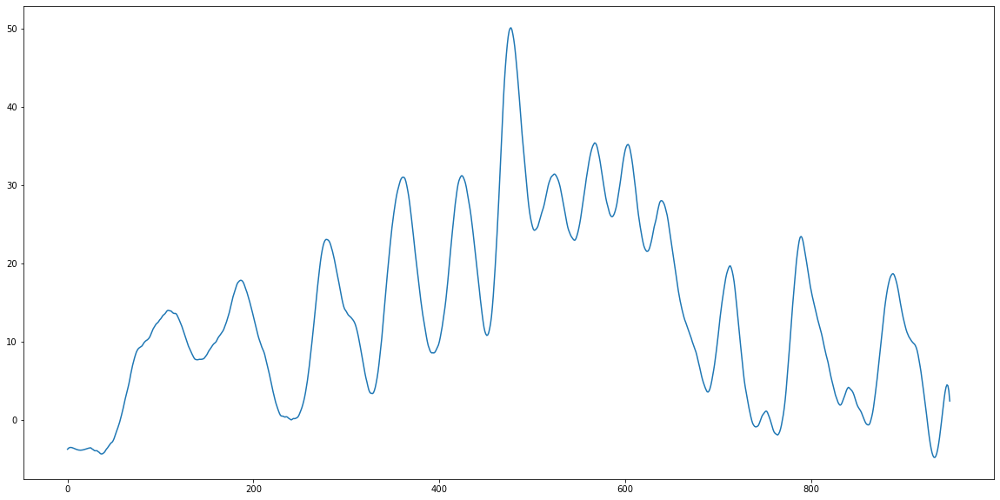

In [135]:
plt.plot(lines_list[0])

The peaks on the left represent smaller DNA fragments, and the peaks on the right - larger ones.

Since the gel line contains 100 bp ladder, the peaks represent following DNA sizes, from right to left: 100, 200, 300, 400, 500, 600 (largest peak), followed by 700, 800, 900, 1000, 1200, 1500 and 2000 bp rightmost band.

# Generating the artificial gel image

Now, using the linearized peaks, we can generate an artificial gel image, where we have a full control over band widths, size of the image, color palette etc.

We will do this by copying the fluorescence vs length array multiple times. This will result with a line. We can also add empty gaps on each side of the line, so the generated gel image looks more natural.

In [136]:
def genGap(length, width):
    return np.zeros((length, width))

In [137]:
def genGelLine(line, width, gap_width):
    line_img = np.zeros((line.shape[0], width))
    
    for i in range(width):
        line_img[:, i] = line[::-1]
    
    if gap_width > 0:
        gap = np.zeros((line.shape[0], gap_width))
        line_img = np.concatenate((gap, line_img, gap), axis=1)
    
    return line_img

In [138]:
def genGel(lines_list, width, gap_width):
    gel_lines_list = list(map(lambda x: genGelLine(x, width, gap_width), lines_list))
    gel = np.concatenate(gel_lines_list, axis=1)
    return gel

Plotting the result for one line. Looks like a gel line, but without any background artifacts!

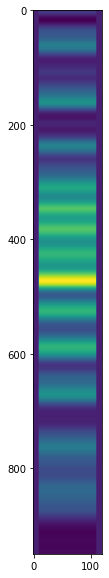

In [139]:
plt.imshow(genGelLiane(lines_list[0], 100, 10))

Now plotting all the lines:

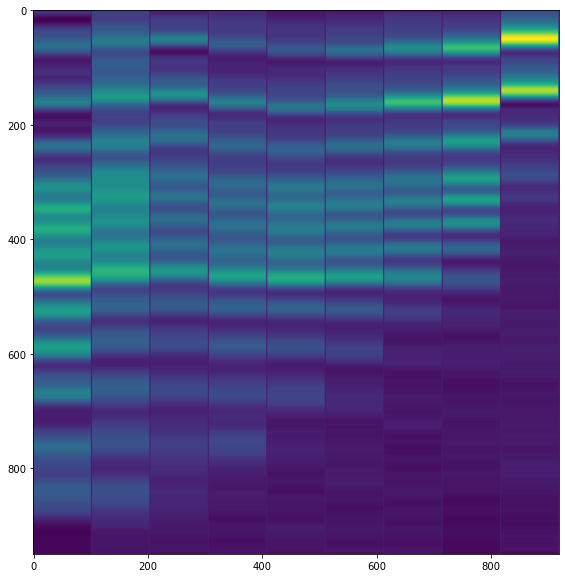

In [141]:
plt.imshow(genGel(lines_list, 100, 1))

You see, the bands are shifted against each other. However, each line contains 2000 bp DNA band (on the top), so the top bands should align.

The misalignment is likely due to slightly deformed gel. 

We can normalize the lines against the top band. Lets find the line where the 2000 bp band is uppermost, and shift the other lines relatively, so their 2000 bp bands are at the same position.

In [142]:
def getMaxBandPos(line, start, finish):
    subline = line[start:finish]
    index = subline.argmax()
    index = start + index
    return index

In [143]:
band_index_list = list(map(lambda x: getMaxBandPos(x, 850, 1000), lines_list))

In [144]:
max_index = max(band_index_list)

In [146]:
aligned_lines = list(map(lambda x, y: shift(x, max_index-y, cval=0), lines_list, band_index_list))

And finally, we can annotate the image. I provided a manual set of coordinates for each text element, found by trial and error. 

If your image is standard, you can also write a custom automated procedure to position the text.

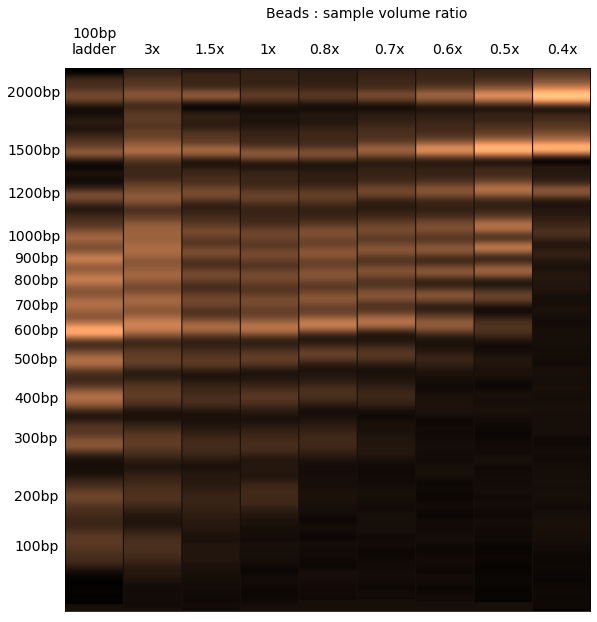

In [147]:
fig,ax = plt.subplots(1)
ax.set_yticklabels([])
ax.set_xticklabels([])
ax.set_xticks([])
ax.set_yticks([])
textstr = "Beads : sample volume ratio"
plt.gcf().text(0.47, 0.95, textstr, fontsize=14)
plt.gcf().text(0.335, 0.90, '100bp\nladder', fontsize=14)
plt.gcf().text(0.385, 0.90, '3x', fontsize=14)
plt.gcf().text(0.42, 0.90, '1.5x', fontsize=14)
plt.gcf().text(0.465, 0.90, '1x', fontsize=14)
plt.gcf().text(0.5, 0.90, '0.8x', fontsize=14)
plt.gcf().text(0.545, 0.90, '0.7x', fontsize=14)
plt.gcf().text(0.585, 0.90, '0.6x', fontsize=14)
plt.gcf().text(0.625, 0.90, '0.5x', fontsize=14)
plt.gcf().text(0.665, 0.90, '0.4x', fontsize=14)

plt.gcf().text(0.295, 0.21, '100bp', fontsize=14)
plt.gcf().text(0.295, 0.28, '200bp', fontsize=14)
plt.gcf().text(0.295, 0.36, '300bp', fontsize=14)
plt.gcf().text(0.295, 0.415, '400bp', fontsize=14)
plt.gcf().text(0.295, 0.47, '500bp', fontsize=14)
plt.gcf().text(0.295, 0.51, '600bp', fontsize=14)
plt.gcf().text(0.295, 0.545, '700bp', fontsize=14)
plt.gcf().text(0.295, 0.58, '800bp', fontsize=14)
plt.gcf().text(0.295, 0.61, '900bp', fontsize=14)
plt.gcf().text(0.290, 0.64, '1000bp', fontsize=14)
plt.gcf().text(0.290, 0.7, '1200bp', fontsize=14)
plt.gcf().text(0.290, 0.76, '1500bp', fontsize=14)
plt.gcf().text(0.290, 0.84, '2000bp', fontsize=14)
ax.imshow(genGel(aligned_lines, 100, 1), cmap='copper')

Good thing you can choose a different color palette or even create your own.

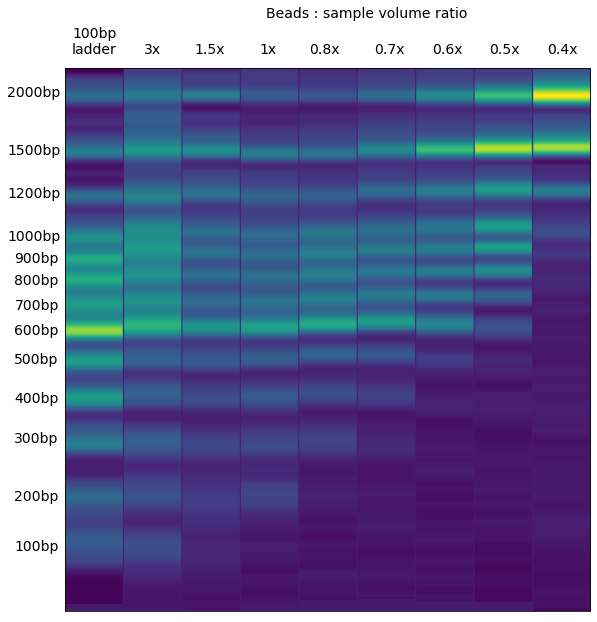

In [148]:
fig,ax = plt.subplots(1)
ax.set_yticklabels([])
ax.set_xticklabels([])
ax.set_xticks([])
ax.set_yticks([])
textstr = "Beads : sample volume ratio"
plt.gcf().text(0.47, 0.95, textstr, fontsize=14)
plt.gcf().text(0.335, 0.90, '100bp\nladder', fontsize=14)
plt.gcf().text(0.385, 0.90, '3x', fontsize=14)
plt.gcf().text(0.42, 0.90, '1.5x', fontsize=14)
plt.gcf().text(0.465, 0.90, '1x', fontsize=14)
plt.gcf().text(0.5, 0.90, '0.8x', fontsize=14)
plt.gcf().text(0.545, 0.90, '0.7x', fontsize=14)
plt.gcf().text(0.585, 0.90, '0.6x', fontsize=14)
plt.gcf().text(0.625, 0.90, '0.5x', fontsize=14)
plt.gcf().text(0.665, 0.90, '0.4x', fontsize=14)

plt.gcf().text(0.295, 0.21, '100bp', fontsize=14)
plt.gcf().text(0.295, 0.28, '200bp', fontsize=14)
plt.gcf().text(0.295, 0.36, '300bp', fontsize=14)
plt.gcf().text(0.295, 0.415, '400bp', fontsize=14)
plt.gcf().text(0.295, 0.47, '500bp', fontsize=14)
plt.gcf().text(0.295, 0.51, '600bp', fontsize=14)
plt.gcf().text(0.295, 0.545, '700bp', fontsize=14)
plt.gcf().text(0.295, 0.58, '800bp', fontsize=14)
plt.gcf().text(0.295, 0.61, '900bp', fontsize=14)
plt.gcf().text(0.290, 0.64, '1000bp', fontsize=14)
plt.gcf().text(0.290, 0.7, '1200bp', fontsize=14)
plt.gcf().text(0.290, 0.76, '1500bp', fontsize=14)
plt.gcf().text(0.290, 0.84, '2000bp', fontsize=14)
ax.imshow(genGel(aligned_lines, 100, 1))

That's it! Let me know if you have any questions, or have your own tricks to share.